In [1]:
# === SECTION 1: Setup and Imports ===
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import zipfile
import cv2
from skimage import io
import random
import glob

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, optimizers
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
import tensorflow.keras.backend as K
from tensorflow.keras.optimizers import AdamW

from sklearn.model_selection import train_test_split
import nibabel as nib

import kagglehub

2025-06-30 15:54:14.912211: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1751298855.089131      35 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1751298855.137338      35 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
# === SECTION 2: Dataset Loading and Preparation ===
path = kagglehub.dataset_download("himanshi549/datasetforpvsegmentation")


In [3]:
dataset_path = '/kaggle/input/datasetforpvsegmentation'
all_files = os.listdir(dataset_path)
image_files = sorted([f for f in all_files if f.endswith('_T2w.nii')])


In [4]:
# Build paired image-mask DataFrame
data = []
for image_file in image_files:
    sub_id = image_file.split('_')[0]
    mask_file = f"{sub_id}_desc-mask_PVS.nii"
    image_full_path = os.path.join(dataset_path, image_file)
    mask_full_path = os.path.join(dataset_path, mask_file)
    if os.path.exists(mask_full_path):
        data.append({"image_path": image_full_path, "mask_path": mask_full_path})
img_df = pd.DataFrame(data)

# Assign labels based on mask content
img_df["Tumor"] = img_df["mask_path"].apply(lambda p: int(np.max(nib.load(p).get_fdata()) > 0))

# Drop any potential NaNs and cast labels to string
img_df.dropna(subset=["Tumor"], inplace=True)
img_df['Tumor'] = img_df['Tumor'].astype(str)

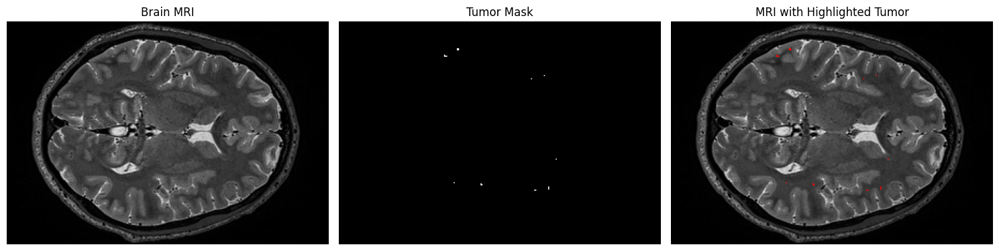

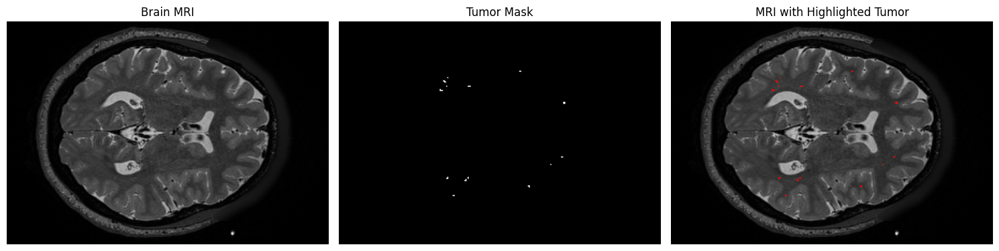

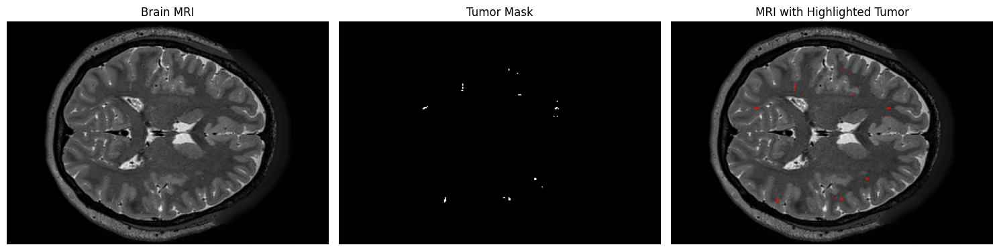

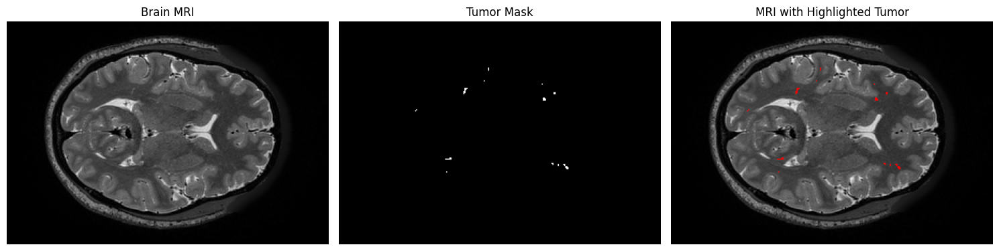

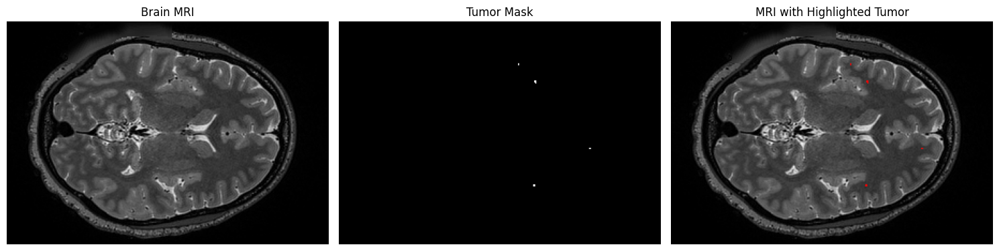

...

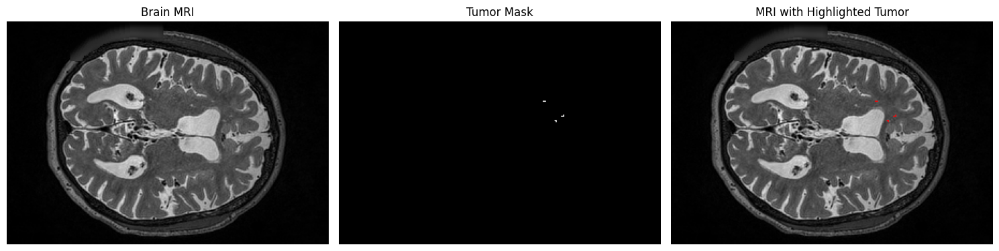

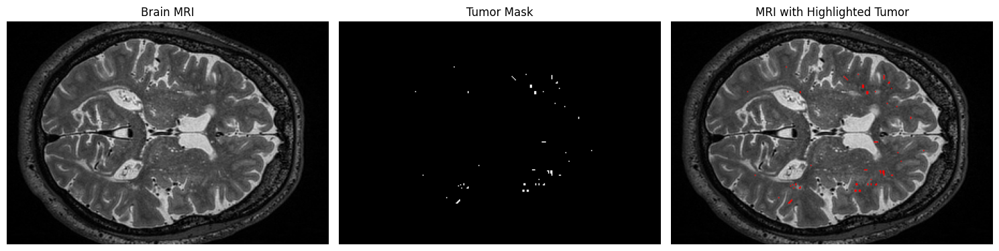

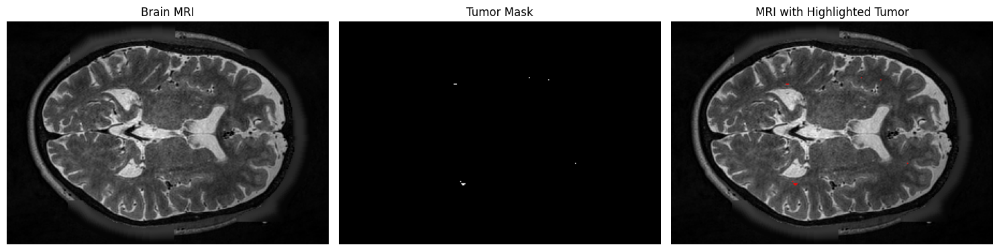

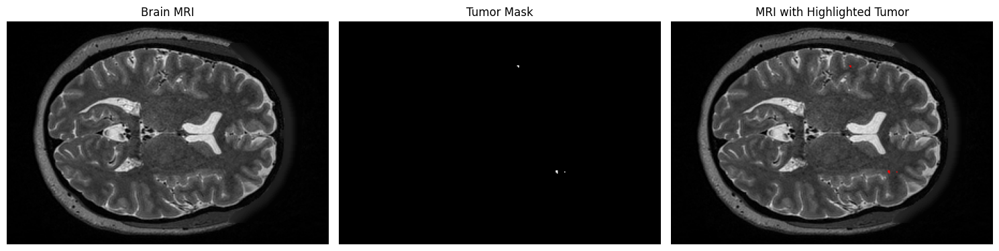

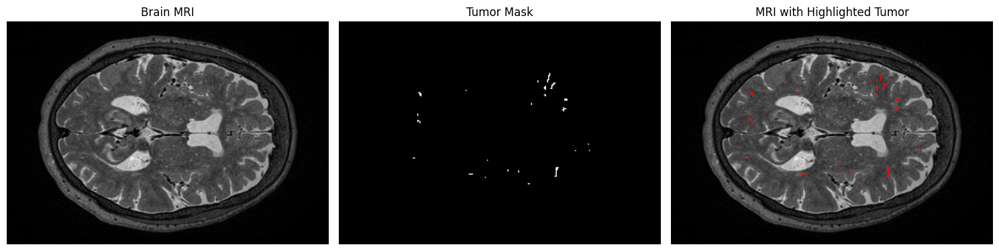

In [5]:
# Visualization (every second sample)
brain_scans = sorted([f for f in all_files if f.endswith('_T2w.nii')])
mask_files = sorted([f for f in all_files if f.endswith('_desc-mask_PVS.nii')])

for i in range(1, min(len(brain_scans), len(mask_files)), 2):
    img_path = os.path.join(dataset_path, brain_scans[i])
    msk_path = os.path.join(dataset_path, mask_files[i])
    try:
        img_data = nib.load(img_path).get_fdata()
        msk_data = nib.load(msk_path).get_fdata()
    except Exception as e:
        print(f"Skipping {img_path} or {msk_path} due to error:\n{e}\n")
        continue
    mid_slice = img_data.shape[2] // 2
    img_slice = cv2.normalize(img_data[:, :, mid_slice], None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    msk_slice = cv2.normalize(msk_data[:, :, mid_slice], None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    img_rgb = cv2.cvtColor(img_slice, cv2.COLOR_GRAY2RGB)
    mask_rgb = cv2.cvtColor(msk_slice, cv2.COLOR_GRAY2RGB)
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))
    ax[0].imshow(img_rgb); ax[0].set_title("Brain MRI"); ax[0].axis('off')
    ax[1].imshow(mask_rgb); ax[1].set_title("Tumor Mask"); ax[1].axis('off')
    contours, _ = cv2.findContours(msk_slice, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    overlay = img_rgb.copy()
    cv2.drawContours(overlay, contours, -1, (255, 0, 0), thickness=-1)
    ax[2].imshow(overlay); ax[2].set_title("MRI with Highlighted Tumor"); ax[2].axis('off')
    plt.tight_layout(); plt.show()

In [6]:
# Split into train/val/test
train_df, test_df = train_test_split(img_df, test_size=0.1, stratify=img_df['Tumor'], random_state=42)
train_df, val_df = train_test_split(train_df, test_size=0.2, stratify=train_df['Tumor'], random_state=42)
# Print shapes
print("Train set size:", train_df.shape)
print("Validation set size:", val_df.shape)
print("Test set size:", test_df.shape)

# Display heads of DataFrames
print("\nTrain sample:")
print(train_df.head())

print("\nValidation sample:")
print(val_df.head())

Train set size: (144, 3)
Validation set size: (36, 3)
Test set size: (20, 3)

Train sample:
                                            image_path  \
142  /kaggle/input/datasetforpvsegmentation/sub-143...   
187  /kaggle/input/datasetforpvsegmentation/sub-188...   
83   /kaggle/input/datasetforpvsegmentation/sub-084...   
171  /kaggle/input/datasetforpvsegmentation/sub-172...   
61   /kaggle/input/datasetforpvsegmentation/sub-062...   

                                             mask_path Tumor  
142  /kaggle/input/datasetforpvsegmentation/sub-143...     1  
187  /kaggle/input/datasetforpvsegmentation/sub-188...     1  
83   /kaggle/input/datasetforpvsegmentation/sub-084...     1  
171  /kaggle/input/datasetforpvsegmentation/sub-172...     1  
61   /kaggle/input/datasetforpvsegmentation/sub-062...     1  

Validation sample:
                                            image_path  \
80   /kaggle/input/datasetforpvsegmentation/sub-081...   
32   /kaggle/input/datasetforpvsegmentation/s

In [7]:
# === SECTION 3: Data Generator ===
class NiiDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, dataframe, batch_size=8, img_size=(256, 256), shuffle=True, augment=False):
        self.df = dataframe.reset_index(drop=True)
        self.batch_size = batch_size
        self.img_size = img_size
        self.shuffle = shuffle
        self.augment = augment
        self.on_epoch_end()

    def __len__(self):
        return int(np.ceil(len(self.df) / self.batch_size))

    def __getitem__(self, index):
        batch_df = self.df.iloc[index * self.batch_size:(index + 1) * self.batch_size]
        X, Y = [], []

        for _, row in batch_df.iterrows():
            try:
                img = nib.load(row["image_path"]).get_fdata()
                mask = nib.load(row["mask_path"]).get_fdata()
                mid = img.shape[2] // 2
                img_slice = cv2.resize(img[:, :, mid], self.img_size)
                mask_slice = cv2.resize(mask[:, :, mid], self.img_size)

                img_slice = (img_slice - np.mean(img_slice)) / (np.std(img_slice) + 1e-5)
                mask_slice = (mask_slice > 0.5).astype(np.float32)

                img_slice = np.expand_dims(img_slice, -1)
                mask_slice = np.expand_dims(mask_slice, -1)

                if self.augment:
                    if random.random() > 0.5:
                        img_slice = np.fliplr(img_slice); mask_slice = np.fliplr(mask_slice)
                    if random.random() > 0.5:
                        img_slice = np.flipud(img_slice); mask_slice = np.flipud(mask_slice)
                    if random.random() > 0.7:
                        k = random.choice([1, 2, 3])
                        img_slice = np.rot90(img_slice, k=k)
                        mask_slice = np.rot90(mask_slice, k=k)
                    if random.random() > 0.5:
                        img_slice = img_slice + 0.01 * np.random.normal(loc=0.0, scale=1.0, size=img_slice.shape)

                X.append(img_slice)
                Y.append(mask_slice)
            except:
                continue

        return np.array(X), np.array(Y)

    def on_epoch_end(self):
        if self.shuffle:
            self.df = self.df.sample(frac=1).reset_index(drop=True)

In [8]:
# === SECTION 4: Metrics and Loss ===
smooth = 1e-6

def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_coef_loss(y_true, y_pred):
    return 1.0 - dice_coef(y_true, y_pred)

def iou(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f) - intersection
    return (intersection + smooth) / (union + smooth)

In [9]:
# === SECTION 5: U-Net Model ===
def unet(input_size=(256, 256, 1)):
    inputs = Input(input_size)

    def conv_block(x, filters, dropout_rate=0.4):
        x = Conv2D(filters, (3, 3), padding='same', kernel_regularizer=tf.keras.regularizers.l2(1e-4))(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        x = Dropout(dropout_rate)(x)
        x = Conv2D(filters, (3, 3), padding='same', kernel_regularizer=tf.keras.regularizers.l2(1e-4))(x)
        x = BatchNormalization()(x)
        x = Activation('relu')(x)
        return x

    def up_block(x, skip, filters):
        x = Conv2DTranspose(filters, (2, 2), strides=(2, 2), padding='same')(x)
        x = concatenate([x, skip])
        x = conv_block(x, filters)
        return x

    c1 = conv_block(inputs, 64)
    p1 = MaxPooling2D((2, 2))(c1)

    c2 = conv_block(p1, 128)
    p2 = MaxPooling2D((2, 2))(c2)

    c3 = conv_block(p2, 256)
    p3 = MaxPooling2D((2, 2))(c3)

    c4 = conv_block(p3, 512)
    p4 = MaxPooling2D((2, 2))(c4)

    c5 = conv_block(p4, 1024)

    u6 = up_block(c5, c4, 512)
    u7 = up_block(u6, c3, 256)
    u8 = up_block(u7, c2, 128)
    u9 = up_block(u8, c1, 64)

    outputs = Conv2D(1, (1, 1), activation='sigmoid')(u9)
    return Model(inputs, outputs)

In [10]:
from tensorflow.keras.optimizers import AdamW  # Make sure this import is added

EPOCHS = 60
BATCH_SIZE = 8
im_height, im_width = 256, 256

train_gen = NiiDataGenerator(train_df, BATCH_SIZE, (im_width, im_height), shuffle=True, augment=True)
val_gen = NiiDataGenerator(val_df, BATCH_SIZE, (im_width, im_height), shuffle=False, augment=False)

model = unet(input_size=(im_height, im_width, 1))
model.compile(
    optimizer=AdamW(learning_rate=1e-4, weight_decay=1e-4),
    loss=dice_coef_loss,
    metrics=['binary_accuracy', iou, dice_coef]
)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', mode='min', patience=4, factor=0.5, min_delta=1e-4, verbose=1)
earlystop = EarlyStopping(monitor='val_loss', patience=8, restore_best_weights=True, verbose=1)
checkpoint = ModelCheckpoint('unet_brain_mri_seg.keras', monitor='val_dice_coef', mode='max', save_best_only=True, verbose=1)

callbacks = [checkpoint, earlystop, reduce_lr]

history = model.fit(
    train_gen,
    steps_per_epoch=max(1, len(train_df) // BATCH_SIZE),
    epochs=EPOCHS,
    validation_data=val_gen,
    validation_steps=max(1, len(val_df) // BATCH_SIZE),
    callbacks=callbacks
)


I0000 00:00:1751299033.174756      35 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 15513 MB memory:  -> device: 0, name: Tesla P100-PCIE-16GB, pci bus id: 0000:00:04.0, compute capability: 6.0
/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/60


I0000 00:00:1751299061.385666      97 service.cc:148] XLA service 0x786ef0003a90 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1751299061.386669      97 service.cc:156]   StreamExecutor device (0): Tesla P100-PCIE-16GB, Compute Capability 6.0
I0000 00:00:1751299063.725914      97 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1751299094.523677      97 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - binary_accuracy: 0.3495 - dice_coef: 0.0018 - iou: 9.0963e-04 - loss: 1.5321
Epoch 1: val_dice_coef improved from -inf to 0.00201, saving model to unet_brain_mri_seg.keras
18/18 ━━━━━━━━━━━━━━━━━━━━ 115s 3s/step - binary_accuracy: 0.3513 - dice_coef: 0.0018 - iou: 9.1507e-04 - loss: 1.5312 - val_binary_accuracy: 0.4743 - val_dice_coef: 0.0020 - val_iou: 0.0010 - val_loss: 1.4715 - learning_rate: 1.0000e-04
Epoch 2/60
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 823ms/step - binary_accuracy: 0.4737 - dice_coef: 0.0030 - iou: 0.0015 - loss: 1.4516
Epoch 2: val_dice_coef improved from 0.00201 to 0.00215, saving model to unet_brain_mri_seg.keras
18/18 ━━━━━━━━━━━━━━━━━━━━ 20s 1s/step - binary_accuracy: 0.4743 - dice_coef: 0.0030 - iou: 0.0015 - loss: 1.4507 - val_binary_accuracy: 0.3612 - val_dice_coef: 0.0022 - val_iou: 0.0011 - val_loss: 1.3932 - learning_rate: 1.0000e-04
Epoch 3/60
18/18 ━━━━━━━━━━━━━━━━━━━━ 0s 799ms/step - binary_accuracy: 0.5280 - dice_coef: 0

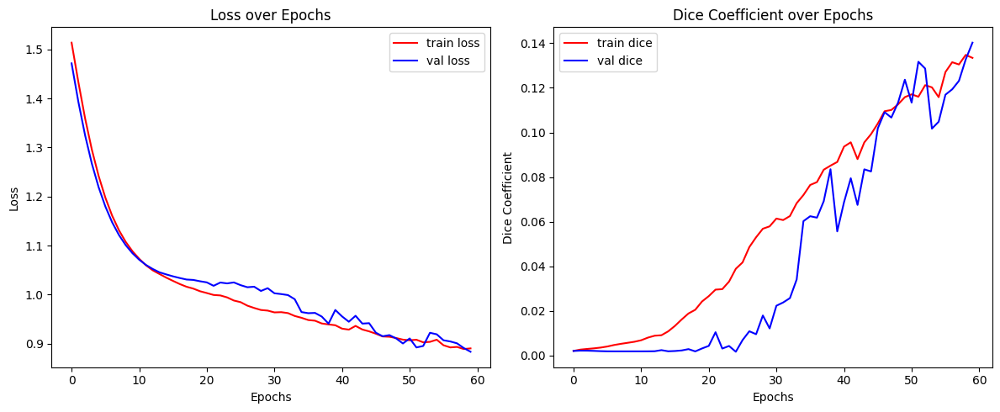

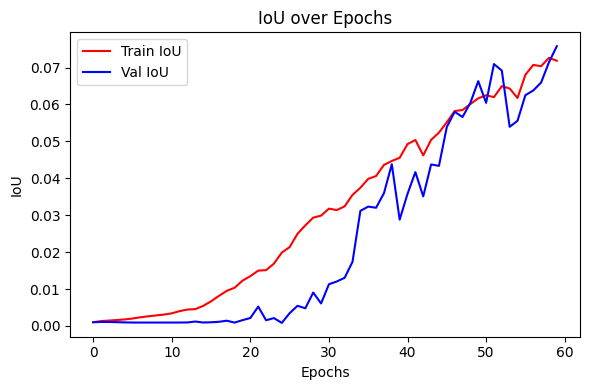

In [11]:
# === SECTION 7: Visualization ===
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], 'r-', label='train loss')
plt.plot(history.history['val_loss'], 'b-', label='val loss')
plt.title('Loss over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['dice_coef'], 'r-', label='train dice')
plt.plot(history.history['val_dice_coef'], 'b-', label='val dice')
plt.title('Dice Coefficient over Epochs')
plt.xlabel('Epochs')
plt.ylabel('Dice Coefficient')
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(6, 4))
plt.plot(history.history['iou'], 'r-', label='Train IoU')
plt.plot(history.history['val_iou'], 'b-', label='Val IoU')
plt.title('IoU over Epochs')
plt.xlabel('Epochs')
plt.ylabel('IoU')
plt.legend()
plt.tight_layout()
plt.show()